In [2]:
import pandas as pd
df = pd.read_csv("c:/lab6/metro.csv")
df = df.drop(["Crime ID", "Context", "LSOA code", "LSOA name"], axis=1)
df = df.dropna(subset=["Longitude"])
df.rename(columns = {"Crime type":"Crime"}, inplace=True)
df = df.head(25000)
df

,Month,Reported by,Falls within,Longitude,Latitude,Location,Crime,Last outcome category
0,2022-07,Metropolitan Police Service,Metropolitan Police Service,0.893762,51.132144,On or near Paper Lane,Violence and sexual offences,Under investigation
1,2022-07,Metropolitan Police Service,Metropolitan Police Service,0.680248,51.099244,On or near Biddenden Road,Violence and sexual offences,Under investigation
2,2022-07,Metropolitan Police Service,Metropolitan Police Service,0.761024,52.030877,On or near Sheepshead Hill,Violence and sexual offences,Under investigation
3,2022-07,Metropolitan Police Service,Metropolitan Police Service,0.135924,51.587353,On or near Gibbfield Close,Anti-social behaviour,NaN
4,2022-07,Metropolitan Police Service,Metropolitan Police Service,0.134947,51.588063,On or near Mead Grove,Anti-social behaviour,NaN
...,...,...,...,...,...,...,...,...
24995,2022-07,Metropolitan Police Service,Metropolitan Police Service,-0.037029,51.643645,On or near Napier Road,Anti-social behaviour,NaN
24996,2022-07,Metropolitan Police Service,Metropolitan Police Service,-0.037029,51.643645,On or near Napier Road,Anti-social behaviour,NaN
24997,2022-07,Metropolitan Police Service,Metropolitan Police Service,-0.037029,51.643645,On or near Napier Road,Criminal damage and arson,Under investigation
24998,2022-07,Metropolitan Police Service,Metropolitan Police Service,-0.037029,51.643645,On or near Napier Road,Other theft,Investigation complete; no suspect identified


In [2]:
import folium
from folium.plugins import MarkerCluster

uk_map = folium.Map(location=[54.70235, -3.27658],zoom_start=5.5)

cases = MarkerCluster().add_to(uk_map)

latitudes = list(df.Latitude)
longitudes = list(df.Longitude)
crime = list(df.Crime)

for lat, lng, crime in zip(latitudes, longitudes, crime):
    folium.Marker(
        location = [lat, lng],
        icon =folium.Icon(color="darkred"),
        popup=crime,
        ).add_to(cases)    
    
uk_map

<AxesSubplot: ylabel='Crime'>

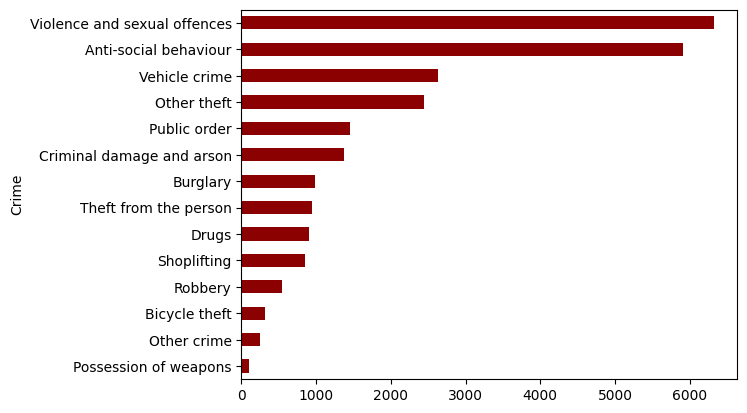

In [3]:
import matplotlib.pyplot as plt
%matplotlib inline 
import sys

df\
.groupby(["Crime"])\
.agg({"Location":"count"})\
.sort_values('Location', ascending=True)\
.plot(kind="barh", legend=False, color="darkred")

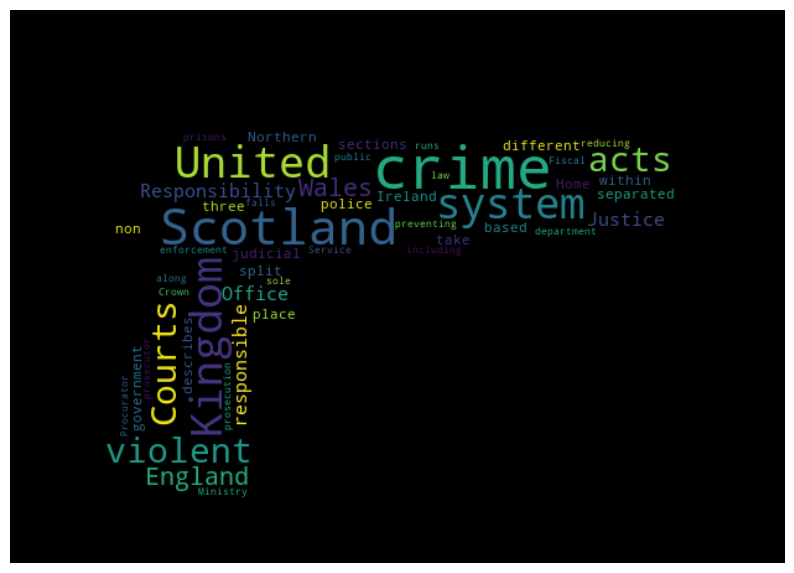

In [4]:
%matplotlib inline
import matplotlib as mpl
import matplotlib.pyplot as plt
mpl.style.use('ggplot') 
from wordcloud import WordCloud, STOPWORDS
import numpy as np
from PIL import Image

mask = np.array(Image.open("mask1.jpg"))

UK_crime = open("wordcl1.txt").read()

stopwords = set(STOPWORDS)

crime_wc = WordCloud(background_color='black', max_words=2000, mask=mask, stopwords=stopwords)

crime_wc.generate(UK_crime)

fig = plt.figure()
fig.set_figwidth(10)
fig.set_figheight(20) 

plt.imshow(crime_wc, interpolation='bilinear')
plt.axis('off')
plt.show()

In [5]:
df = pd.read_csv("NBA.csv")
df = df.drop(df.iloc[:, 5:28], axis=1)
df = df.drop(["NBA_DraftNumber"], axis=1)
df

,Player,Salary,NBA_Country,Age
0,Zhou Qi,815615,China,22
1,Zaza Pachulia,3477600,Georgia,33
2,Zach Randolph,12307692,USA,36
3,Zach LaVine,3202217,USA,22
4,Zach Collins,3057240,USA,20
...,...,...,...,...
480,Al Horford,27734405,Dominican Rep...,31
481,Abdel Nader,1167333,Egypt,24
482,Aaron Harrison,83129,USA,23
483,Aaron Gordon,5504420,USA,22


<AxesSubplot: xlabel='Age'>

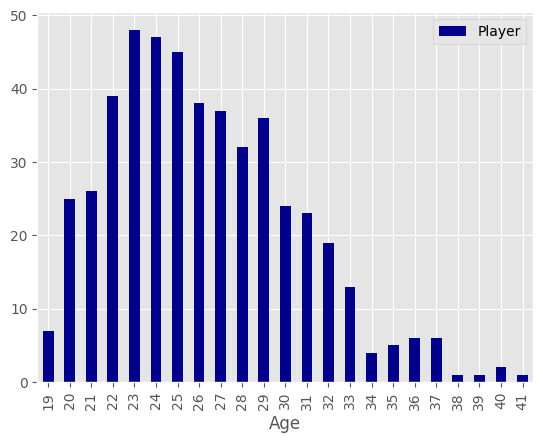

In [6]:
import matplotlib.pyplot as plt
%matplotlib inline 
import sys

df\
.groupby(["Age"])\
.agg({"Player":"count"})\
.plot(kind="bar",color="darkblue")

<AxesSubplot: ylabel='NBA_Country'>

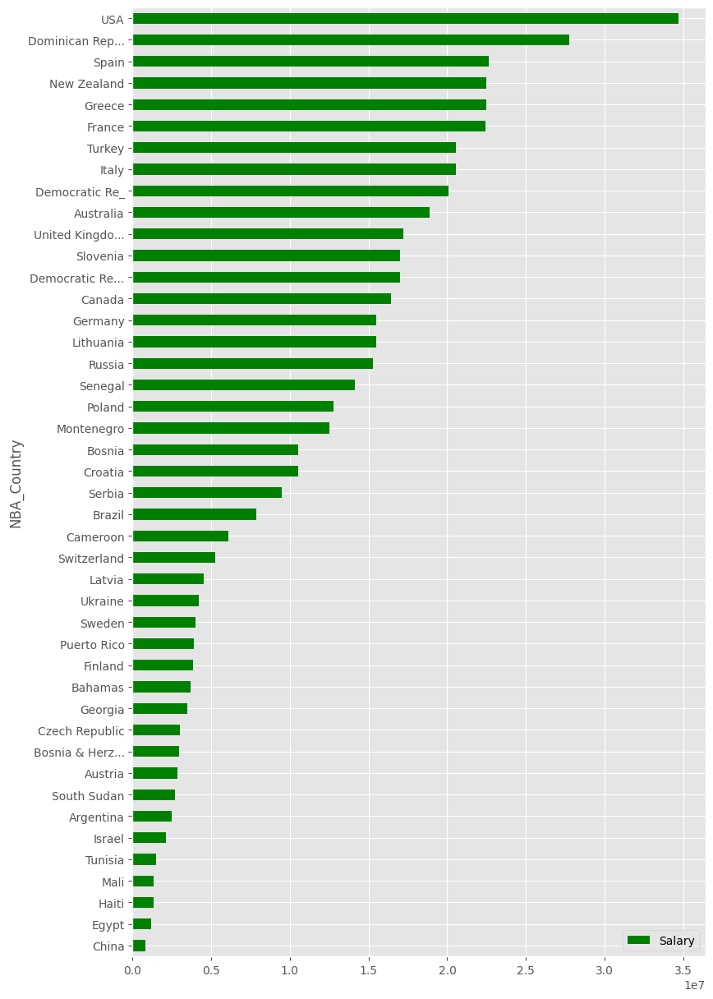

In [7]:
df\
.groupby(["NBA_Country"])\
.agg({"Salary":"max"})\
.sort_values('Salary', ascending=True)\
.plot(kind="barh",color="green", figsize=[9,15])

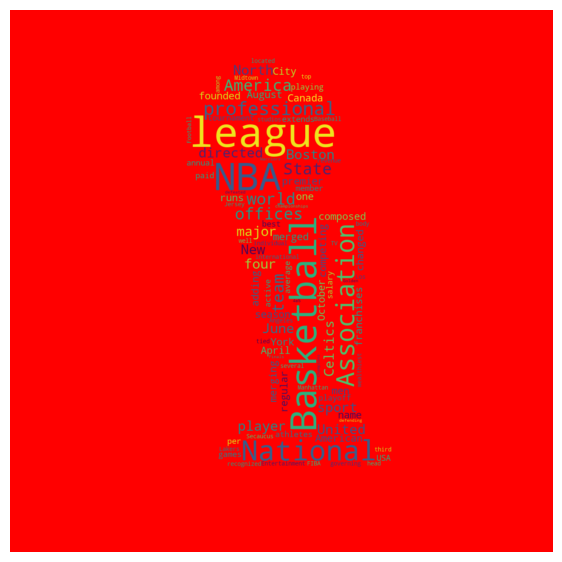

In [8]:
%matplotlib inline
import matplotlib as mpl
import matplotlib.pyplot as plt
mpl.style.use('ggplot') 
from wordcloud import WordCloud, STOPWORDS
import numpy as np
from PIL import Image

mask = np.array(Image.open("mask2.jpg"))

NBA = open("wordcl2.txt").read()

stopwords = set(STOPWORDS)

NBA_wc = WordCloud(background_color='red', max_words=2000, mask=mask, stopwords=stopwords)

NBA_wc.generate(NBA)

fig = plt.figure()
fig.set_figwidth(7)
fig.set_figheight(9) 

plt.imshow(NBA_wc, interpolation='bilinear')
plt.axis('off')
plt.show()